image id 25


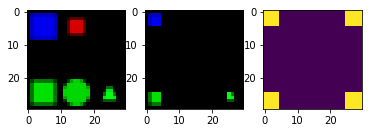

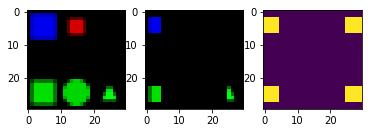

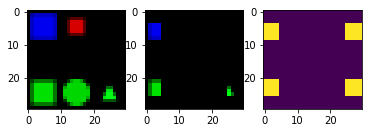

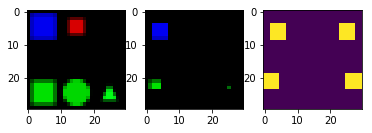

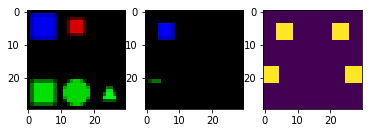

...

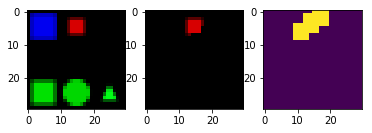

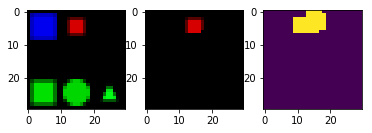

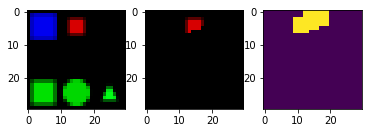

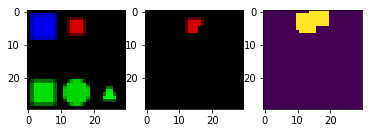

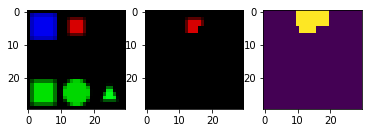


[MoviePy] Building file tmp/gifs/num_agents=4,comm_mode=from_states,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=True,fix_image=False/1.gif with imageio


100%|██████████| 32/32 [00:01<00:00, 20.50it/s]


image id 25


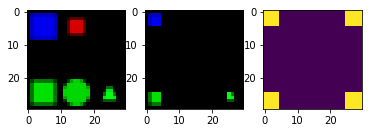

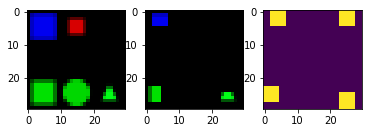

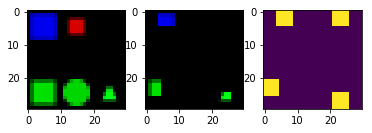

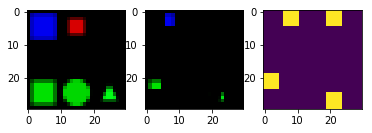

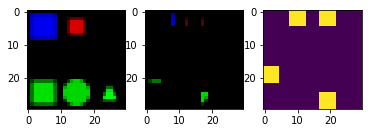

...

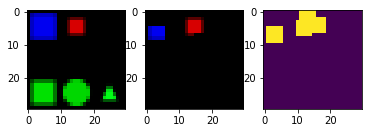

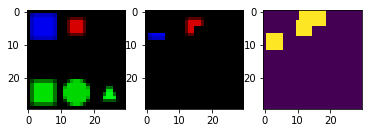

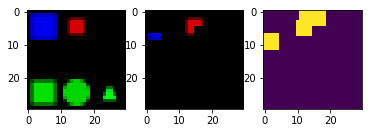

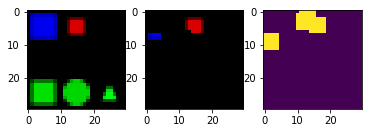

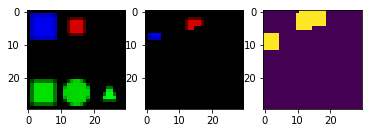


[MoviePy] Building file tmp/gifs/num_agents=4,comm_mode=no_comm,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=True,fix_image=False/1.gif with imageio


100%|██████████| 32/32 [00:01<00:00, 19.70it/s]


image id 26


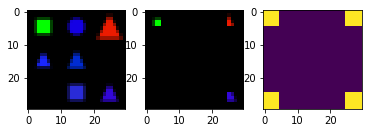

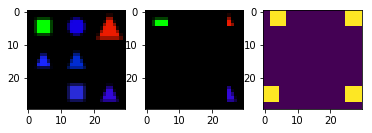

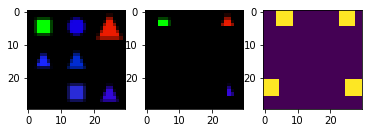

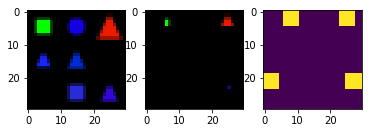

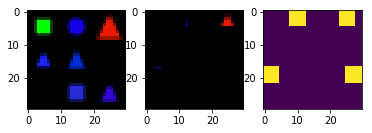

...

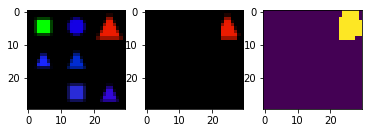

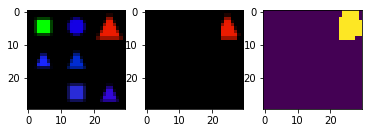

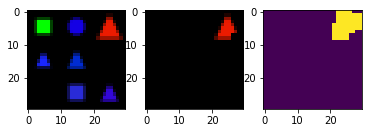

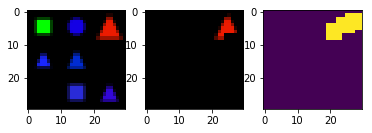

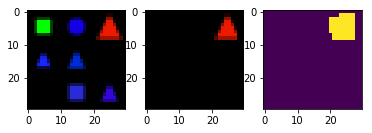


[MoviePy] Building file tmp/gifs/num_agents=4,comm_mode=from_states,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=True,fix_image=False/2.gif with imageio


100%|██████████| 32/32 [00:01<00:00, 21.56it/s]


image id 26


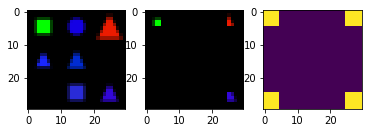

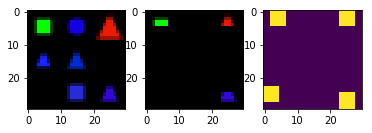

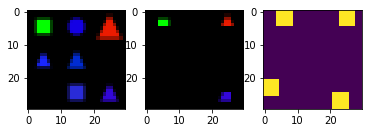

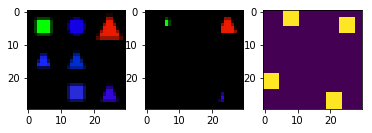

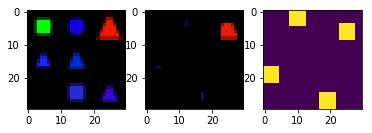

...

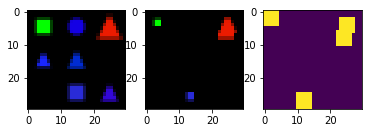

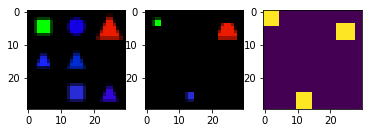

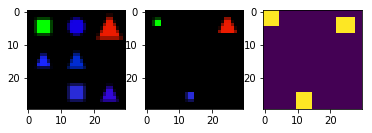

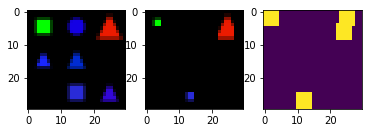

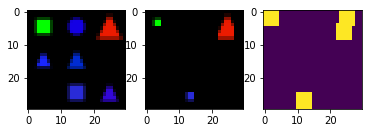


[MoviePy] Building file tmp/gifs/num_agents=4,comm_mode=no_comm,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=True,fix_image=False/2.gif with imageio


100%|██████████| 32/32 [00:01<00:00, 19.79it/s]


image id 27


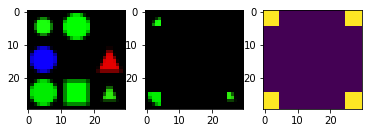

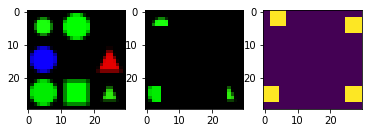

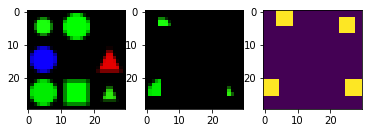

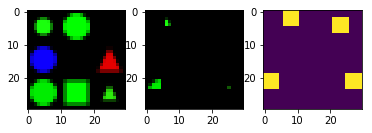

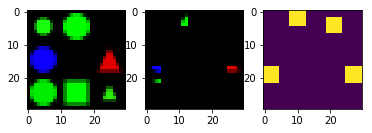

...

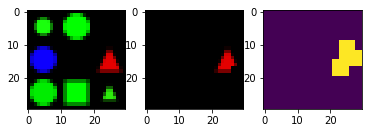

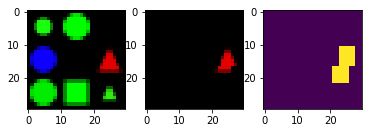

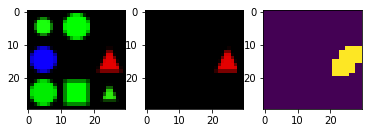

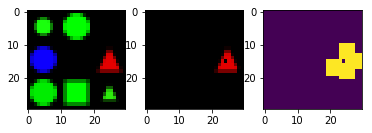

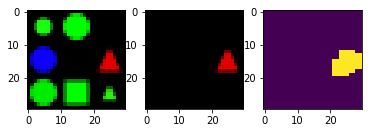


[MoviePy] Building file tmp/gifs/num_agents=4,comm_mode=from_states,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=True,fix_image=False/3.gif with imageio


100%|██████████| 32/32 [00:01<00:00, 21.96it/s]


image id 27


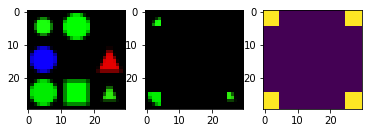

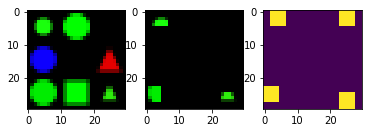

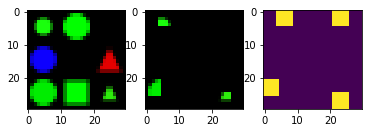

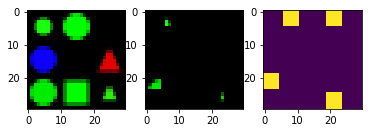

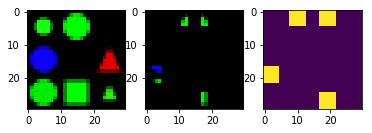

...

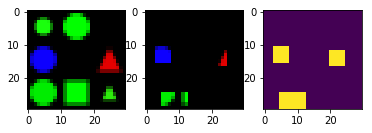

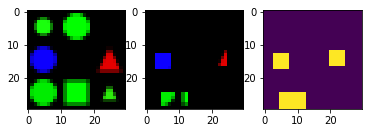

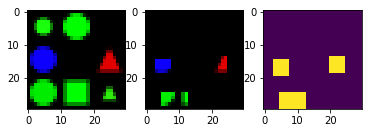

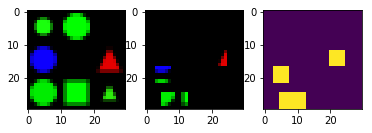

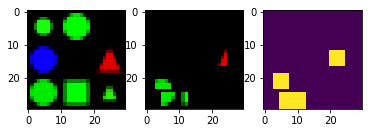


[MoviePy] Building file tmp/gifs/num_agents=4,comm_mode=no_comm,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=True,fix_image=False/3.gif with imageio


100%|██████████| 32/32 [00:01<00:00, 20.85it/s]


image id 31


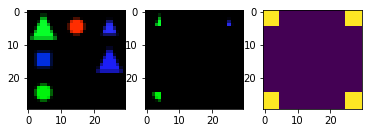

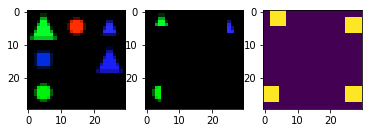

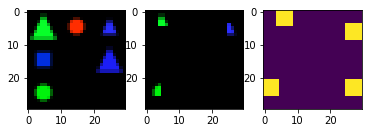

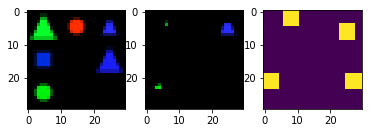

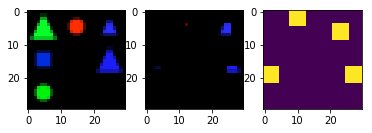

...

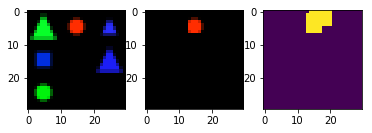

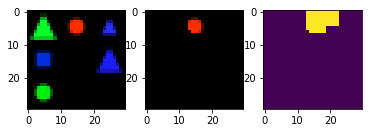

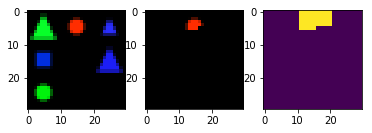

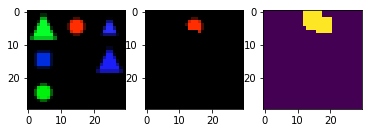

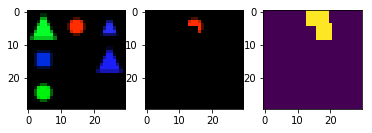


[MoviePy] Building file tmp/gifs/num_agents=4,comm_mode=from_states,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=True,fix_image=False/4.gif with imageio


100%|██████████| 32/32 [00:01<00:00, 20.22it/s]


image id 31


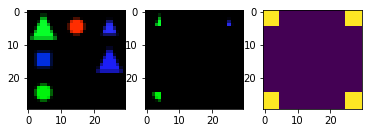

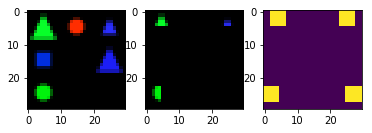

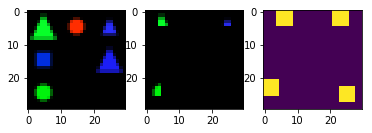

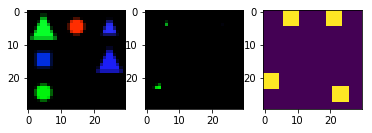

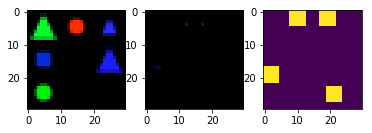

...

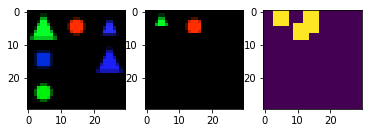

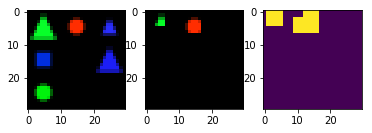

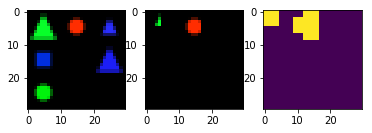

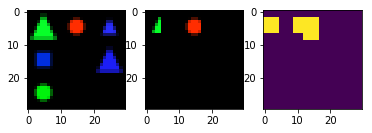

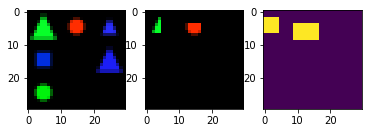


[MoviePy] Building file tmp/gifs/num_agents=4,comm_mode=no_comm,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=True,fix_image=False/4.gif with imageio


100%|██████████| 32/32 [00:01<00:00, 19.87it/s]


image id 43


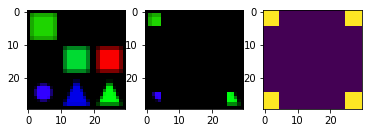

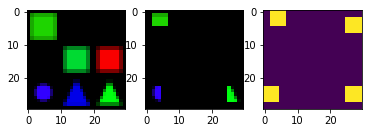

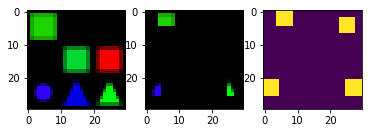

KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

In [3]:
import matplotlib
matplotlib.use('Agg')

import torch

import gym 
import gym_simple_grid
import gym_shapes

import shutil
import glob
import os
import moviepy.editor as mpy

base_dir = "checkpoints/"
env_name = "ShapesEnv-v0"#"SimpleGridEnv-v0" "ShapesEnv-v0" "SimpleShapesEnv-v0"

fps = 5
temp_dir = 'tmp/imgs/'
root_gif_dir = 'tmp/gifs/'

# agent_positions = [(25, 25), (20, 25), (25, 20), (20, 20)]
# goal_position = (0, 25)

# overfitting
# models = ["num_agents=4,comm_mode=from_states,step_size=2,num_steps=30,state_size=128,comm_size=3",
#           "num_agents=4,comm_mode=from_states,step_size=3,num_steps=30,state_size=128,comm_size=3",
#           "num_agents=4,comm_mode=from_states,step_size=4,num_steps=30,state_size=128,comm_size=3",
#           "num_agents=4,comm_mode=from_states,step_size=5,num_steps=30,state_size=128,comm_size=3"]

# 07/02
# with and without comm, large, fixed spawns
# img_ids = [25, 26, 27, 31, 43, 64, 69, 76, 80, 82, 85, 93]
# models = ["num_agents=4,comm_mode=from_states,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=True,fix_image=False",
#           "num_agents=4,comm_mode=no_comm,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=True,fix_image=False"]
# fix_spawn = True
# fix_image = False

# 07/03
# with and without comm, large, variable spawns
img_ids = [25, 26, 27, 31, 43, 64, 69, 76, 80, 82, 85, 93]
models = ["num_agents=4,comm_mode=no_comm,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=False,fix_image=False",
          "num_agents=4,comm_mode=from_states,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=False,fix_image=False"]
fix_spawn = False
fix_image = False

for i in range(len(img_ids)):
    
    for j in range(len(models)):
    
        hparam_str = models[j]

        # Retrieve trained model
        path = os.path.join(base_dir, hparam_str, env_name + ".pt")
        actor_critic = torch.load(path)

        # Create environment
        env = gym.make(env_name)
        env.n_agents = actor_critic.n_agents

        env.fix_spawn = False
        env.fix_image = False
        env.step_size = 2

        try:
            os.makedirs(temp_dir)
        except OSError:
            shutil.rmtree(temp_dir)
            os.makedirs(temp_dir)
        
        gif_dir = os.path.join(root_gif_dir, hparam_str)
        try:
            os.makedirs(gif_dir)
        except:
            pass

        # Run episode and save png images with .render()
        obs = env.reset(img_idx=img_ids[i])
        states = torch.zeros(1, actor_critic.n_agents, actor_critic.state_size)
        communications = torch.zeros(1, actor_critic.n_agents, actor_critic.comm_size)
        masks = torch.ones(1, 1)

        env.render(save_dir=temp_dir)

        while True:
            obs = torch.FloatTensor(obs).unsqueeze(0)

            value, actions, actions_log_probs, states, communications = actor_critic.act(
                obs, states, communications, masks)
            actions = actions[0, :, 0].cpu().numpy()

            obs, reward, done, _ = env.step(actions)

            env.render(save_dir=temp_dir)

            if done:
                break

        # Create gif
        gif_name = os.path.join(gif_dir, str(i+1) + '.gif')
        file_list = glob.glob(temp_dir + '*.png')
        file_list.sort()
        clip = mpy.ImageSequenceClip(file_list, fps=fps)
        clip.write_gif(gif_name, fps=fps)

In [1]:
import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

In [5]:
data = np.load('gym_shapes/data/shapes/shapes_06_05_08:34/train.tiny.input.npy')[:, :, :, ::-1]
print(data.shape)

(64, 30, 30, 3)


In [2]:
plt.imshow(data[25])

NameError: name 'plt' is not defined

In [2]:
import json
import numpy as np
d = json.load(open('gym_shapes/data/shapes/shapes_06_05_08:34/train.large.colors', 'r'))
print(len(d))

13568


In [3]:
red_ids = []
for i in range(len(d)):
    if (np.array(d[i])==0).sum() == 1:
        red_ids.append(i)
print(len(red_ids))

2784


In [ ]:
img_ids = [25, 26, 27, 31, 43, 64, 69, 76, 80, 82, 85, 93]

## better visualization

In [6]:
import matplotlib
matplotlib.use('Agg')
%matplotlib inline

import torch

import gym 
import gym_simple_grid
import gym_shapes

from gym.envs.registration import register

import shutil
import glob
import os
import moviepy.editor as mpy

%load_ext autoreload
%autoreload 2

base_dir = 'checkpoints/07_05/'
fps = 5
root_temp_dir = 'tmp/imgs/07_05/'
root_gif_dir = 'tmp/gifs/07_05/'

# default data params
data_dir = 'shapes_3x3_single_red'
task = 'colors.0'
num_agents = 4
step_size = 2
num_steps = 30
obs_height = 5
obs_width = 5
fix_spawn = False
fix_image = False

# 07/04
# with attention
# data_dir = 'shapes_3x3_single_red'
# img_ids = [x for x in range(20)]
# models = ["shapes_3x3_single_red,num_agents=4,comm_mode=from_states_rec_att,step_size=2,num_steps=30,state_size=128,comm_size=32,fix_spawn=True,fix_image=False"]
# fix_spawn = True
# fix_image = False
# step_size = 2
# num_steps = 100
# fps = 10

# 07/05
# 8 agents with attention
data_dir = 'shapes_5x5_single_red'
img_ids = [x for x in range(20)]
models = ["shapes_5x5_single_red,num_agents=8,comm_mode=from_states_rec_att,step_size=2,num_steps=100,state_size=128,comm_size=32,fix_spawn=False,fix_image=False"]
fix_spawn = False
fix_image = False
num_agents = 8
step_size = 2
num_steps = 80
fps = 10

# re-register env
# register(id='CustomShapesEnv-v3', entry_point='gym_shapes.shapes_env:ShapesEnv', kwargs={
#     'data_dir': data_dir,
#     'task': task,
#     'num_agents': num_agents,
#     'step_size': step_size,
#     'num_steps': num_steps,
#     'obs_height': obs_height,
#     'obs_width': obs_width,
#     'fix_spawn': fix_spawn,
#     'fix_image': fix_image
# })

hparam_str = models[0]

# Retrieve trained model
path = os.path.join(base_dir, hparam_str, "ShapesEnv-v0.pt")
actor_critic = torch.load(path, map_location={'cuda:0': 'cpu'})

# Create environment
env = gym.make('CustomShapesEnv-v3')

gif_dir = os.path.join(root_gif_dir, hparam_str)
try:
    os.makedirs(gif_dir)
except:
    pass

temp_dir = os.path.join(root_temp_dir, hparam_str, str(img_ids[1]))
try:
    os.makedirs(temp_dir)
except:
    pass

# Run episode and save png images with .render()
obs = env.reset(img_idx=img_ids[1])
states = torch.zeros(1, actor_critic.n_agents, actor_critic.state_size)
communications = torch.zeros(1, actor_critic.n_agents, actor_critic.comm_size)
masks = torch.ones(1, 1)

obs = torch.FloatTensor(obs).unsqueeze(0)
value, actions, actions_log_probs, states, communications, aux = actor_critic.act(
    obs, states, communications, masks)
actions = actions[0, :, 0].cpu().numpy()
obs, reward, done, _ = env.step(actions)
env.render(aux=aux)

# while True:
#     obs = torch.FloatTensor(obs).unsqueeze(0)

#     value, actions, actions_log_probs, states, communications, aux = actor_critic.act(
#         obs, states, communications, masks)
#     actions = actions[0, :, 0].cpu().numpy()

#     obs, reward, done, _ = env.step(actions)

#     env.render(aux=aux)

#     if done:
#         break

# # Create gif
# gif_name = os.path.join(gif_dir, str(i+1) + '.gif')
# file_list = glob.glob(temp_dir + '*.png')
# file_list.sort()
# clip = mpy.ImageSequenceClip(file_list, fps=fps)
# clip.write_gif(gif_name, fps=fps)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


UnregisteredEnv: No registered env with id: CustomShapesEnv-v3

## trying out pcolor

[[0.1  0.4  0.25 0.25]
 [0.25 0.25 0.25 0.25]
 [0.25 0.25 0.25 0.25]
 [0.25 0.25 0.25 0.25]]


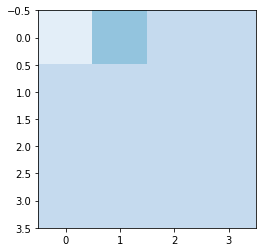

In [185]:
a = np.array([[0.10, 0.40, 0.25, 0.25],
              [0.25, 0.25, 0.25, 0.25],
              [0.25, 0.25, 0.25, 0.25],
              [0.25, 0.25, 0.25, 0.25]])
plt.imshow(a, cmap='Blues', vmin=0.0, vmax=1.0)
print(a)

## single target datasets

In [147]:
import json
import numpy as np
import matplotlib.pyplot as plt

set_id = 'shapes_single_red_5x5'
label_id = 'colors'

labels = json.load(open('gym_shapes/data/shapes/' + set_id + '/train.large.' + label_id, 'r'))
data = np.load('gym_shapes/data/shapes/' + set_id + '/train.large.input.npy')[:, :, :, ::-1]

print(len(labels))
print(data.shape)

13568
(13568, 50, 50, 3)


[[1, 1, 2, 2, None], [2, 2, None, None, 2], [None, 0, None, 1, None], [1, None, 1, 2, 2], [None, 2, 1, 2, 2]]


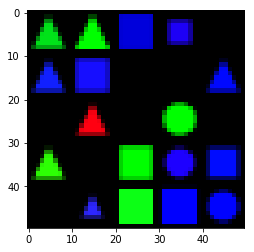

In [150]:
instance_id = 2

plt.imshow(data[instance_id])
print(labels[instance_id])

## visualizing traffic junction

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
25

100%|██████████| 501/501 [00:02<00:00, 199.92it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: tmp/gifs/08_08/08_08_164417_TrafficEnv-v0,difficulty=hard,comm_mode=from_states_rec_att,comm_nhops=2,state_size=128,comm_size=32/viz.mp4 



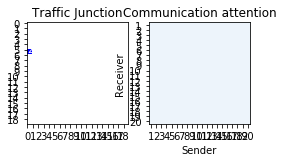

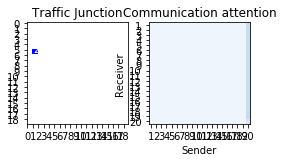

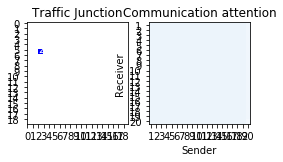

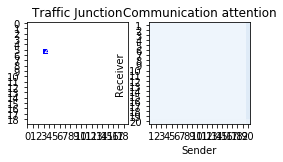

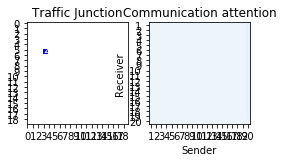

...

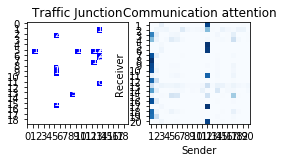

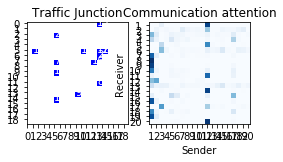

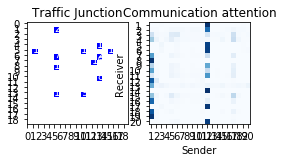

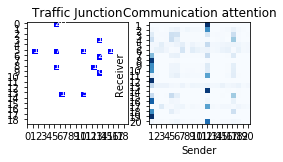

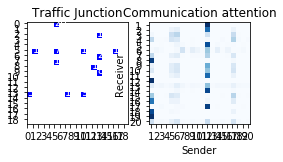

In [2]:
import matplotlib
matplotlib.use('Agg')
%matplotlib inline

import torch

import gym 
import gym_traffic

from gym.envs.registration import register
from arguments import traffic_env_config

import shutil
import glob
import os
import moviepy.editor as mpy

%load_ext autoreload
%autoreload 2

base_dir = 'checkpoints/08_08/'
fps = 10
root_temp_dir = 'tmp/imgs/08_08/'
root_gif_dir = 'tmp/gifs/08_08/'

# default data params
difficulty = 'hard'
models = ['08_08_164417_TrafficEnv-v0,difficulty=hard,comm_mode=from_states_rec_att,comm_nhops=2,state_size=128,comm_size=32/']
# models = ['08_08_164238_TrafficEnv-v0,difficulty=hard,comm_mode=from_states_rec_att,comm_nhops=1,state_size=128,comm_size=32/']

# register(
#     id='CustomTrafficEnv-v2',
#     entry_point='gym_traffic.traffic_env:TrafficEnv',
#     kwargs={
#         'num_steps': 60,
#         'difficulty': difficulty,
#         'dim': traffic_env_config[difficulty]['dim'],
#         'vision': traffic_env_config[difficulty]['vision'],
#         'num_agents': traffic_env_config[difficulty]['num_agents']
#     })

hparam_str = models[0]

# Retrieve trained model
path = os.path.join(base_dir, hparam_str, "TrafficEnv-v0.pt")
actor_critic = torch.load(path, map_location={'cuda:0': 'cpu'})

# Create environment
env = gym.make('CustomTrafficEnv-v2')
env.num_steps = 500

gif_dir = os.path.join(root_gif_dir, hparam_str)
try:
    os.makedirs(gif_dir)
except:
    pass

temp_dir = os.path.join(root_temp_dir, hparam_str)
try:
    os.makedirs(temp_dir)
except:
    pass

# Run episode and save png images with .render()
obs = env.reset()
states = torch.zeros(1, actor_critic.n_agents, actor_critic.state_size)
communications = torch.zeros(1, actor_critic.n_agents, actor_critic.comm_size)
masks = torch.ones(1, 1)

obs = torch.FloatTensor(obs).unsqueeze(0)
value, actions, actions_log_probs, states, communications, aux = actor_critic.act(
    obs, states, communications, masks)
actions = actions[0, :, 0].cpu().numpy()
obs, reward, done, _ = env.step(actions)
env.render(aux=aux, save_dir=temp_dir)
# env.render(aux=aux)

while True:
    obs = torch.FloatTensor(obs).unsqueeze(0)
    value, actions, actions_log_probs, states, communications, aux = actor_critic.act(
        obs, states, communications, masks)
    actions = actions[0, :, 0].cpu().numpy()
    obs, reward, done, _ = env.step(actions)
    print(env.n_steps)
    env.render(aux=aux, save_dir=temp_dir)

    if done:
        break

# Create gif
gif_name = os.path.join(gif_dir, 'viz.mp4')
file_list = glob.glob(temp_dir + '*.png')
file_list.sort()
clip = mpy.ImageSequenceClip(file_list, fps=fps)
clip.write_videofile(gif_name, fps=fps)

In [33]:
gif_name = os.path.join(gif_dir, 'viz.gif')
file_list = glob.glob(temp_dir + '*.png')
file_list.sort()
clip = mpy.ImageSequenceClip(file_list, fps=fps)
clip.write_gif(gif_name, fps=fps)


[MoviePy] Building file tmp/gifs/08_08/08_08_164215_TrafficEnv-v0,difficulty=easy,comm_mode=from_states_rec_att,comm_nhops=1,state_size=128,comm_size=32/viz.gif with imageio


100%|██████████| 201/201 [00:05<00:00, 34.12it/s]


## visualizing house3d

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Loaded 4 api threads on gpu 1
[2 2 2 2] [0, 0, 0, 0]
2
[2 2 2 2] [0, 0, 0, 0]
3
[2 2 2 2] [0, 0, 0, 0]
4
[2 1 0 2] [0, 0, 0.03461538461538462, 0]
5
[2 1 0 2] [0, 0, 0.03076923076923077, 0]
6
[2 1 0 2] [0, 0, 1.0346153846153847, 0]
7
[2 1 0 2] [0, 0, 1.0076923076923077, 0]
8
[2 1 1 2] [0, 0, 1.0, 0]
9
[2 1 1 2] [0, 0, 1.0, 0]
10
[2 1 1 2] [0, 0, 1.0, 0]
11
[2 1 1 2] [0, 0, 1.0, 0]
12
[1 1 2 2] [0, 0, 1.0, 0]
13
[1 2 1 2] [0, 0, 1.0, 0]
14
[2 2 1 2] [0, 0, 1.0, 0]
15
[2 1 2 0] [0, 0, 1.0, 0.06]
16
[1 1 2 0] [0, 0, 1.0, 0.05]
17
[1 2 1 2] [0, 0, 1.0, 0]
18
[1 1 2 2] [0, 0, 1.0, 0]
19
[1 1 1 0] [0, 0, 1.0, 1.025]
20
[2 2 2 0] [0, 0, 1.0, 1.0]
21
[1 2 1 0] [0, 0, 1.0, 1.0]
22
[2 2 1 1] [0, 0, 1.0, 1.0]
23
[1 2 2 1] [0, 0, 1.0, 1.0]
24
[2 1 1 1] [0, 0, 1.0, 1.0]
25
[1 2 2 1] [0, 0, 1.0, 1.0]
26
[2 1 2 0] [0, 0, 1.0, 1.0]
27
[1 1 1 1] [0, 0, 1.0, 1.0]
28
[2 1 2 2] [0, 0, 1.0, 1.0]
29
[1 1 1 0] [0, 0, 1.0, 

100%|██████████| 50/50 [00:03<00:00, 14.37it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: tmp/gifs/09_18/09_18_001127_House3DEnv-v0,num_agents=4,num_steps=30,comm_mode=from_states,comm_nhops=1,state_size=128,comm_size=32/viz.mp4 



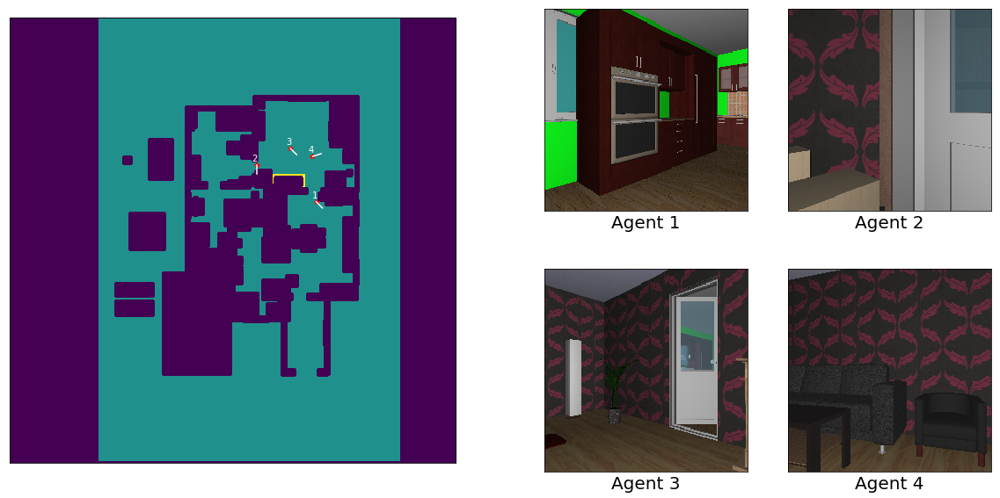

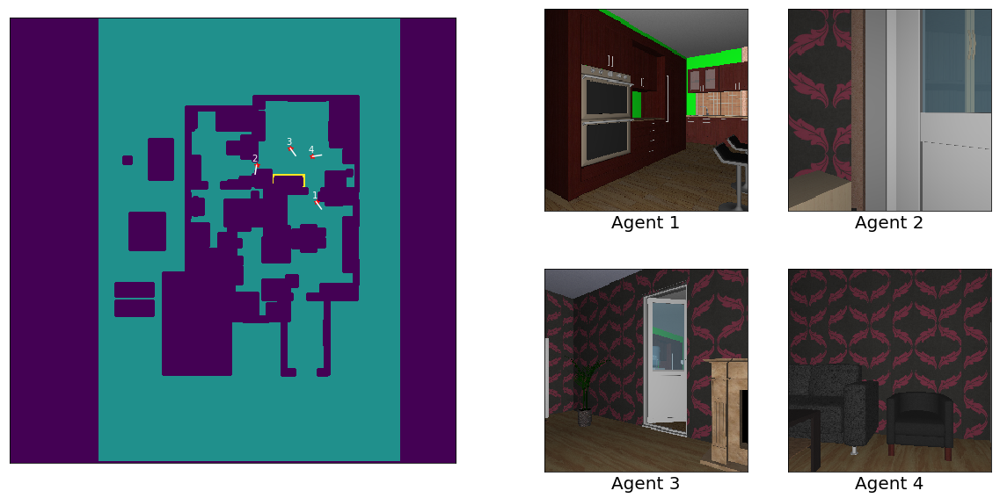

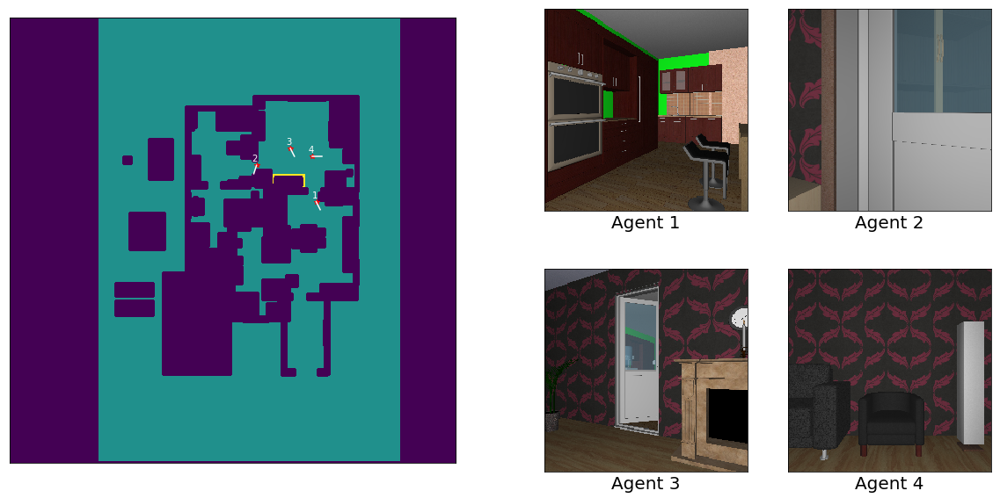

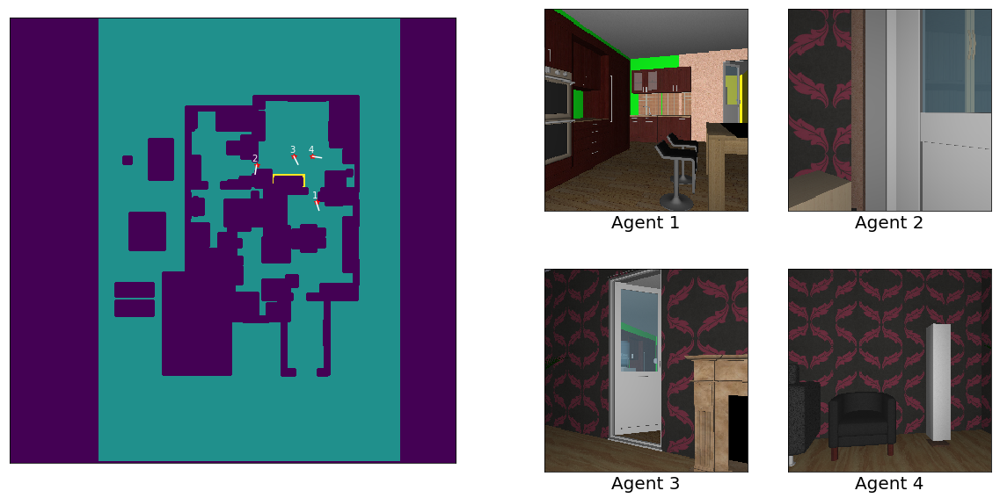

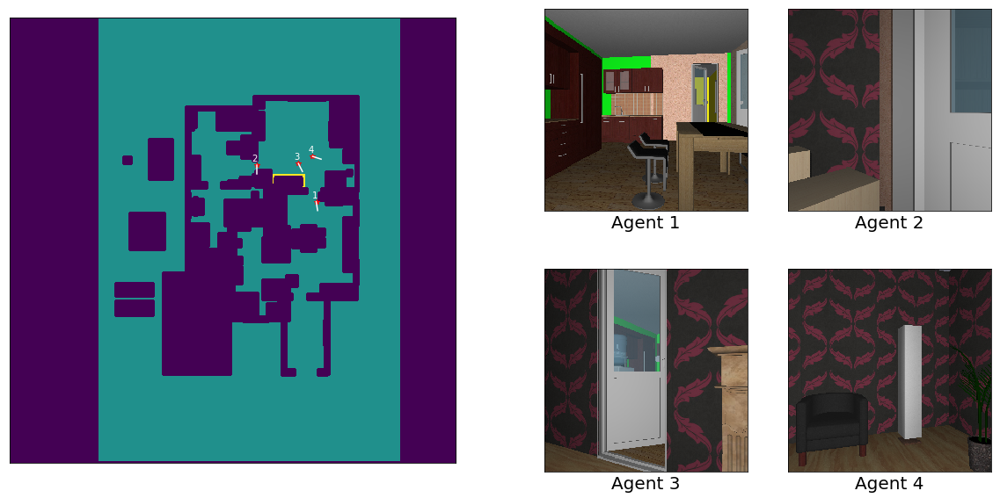

...

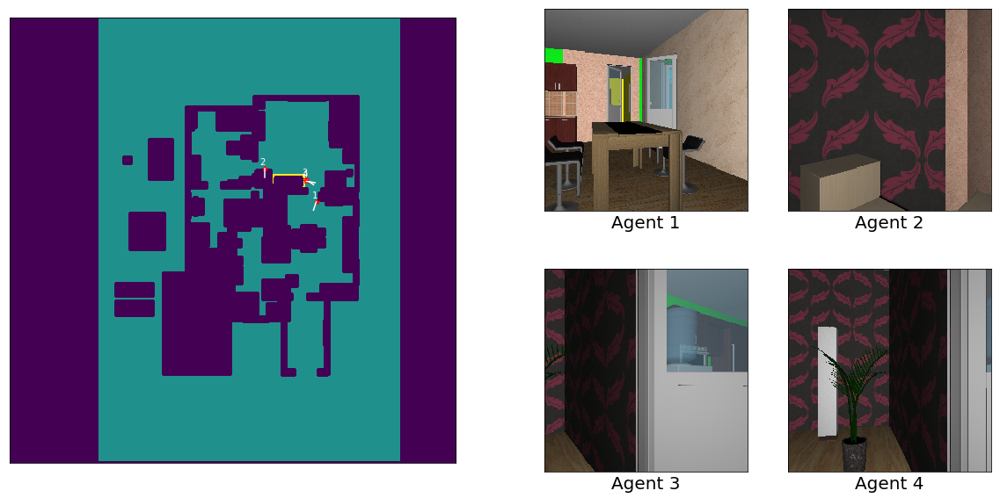

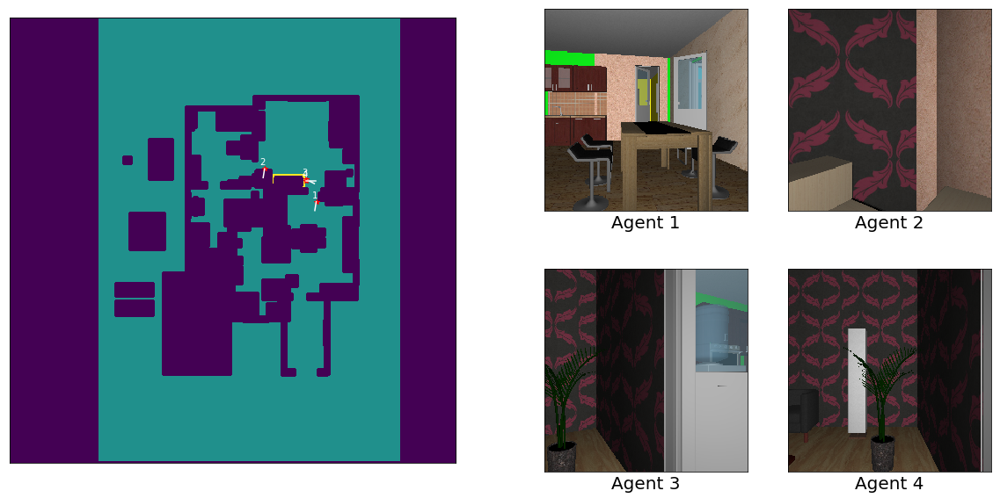

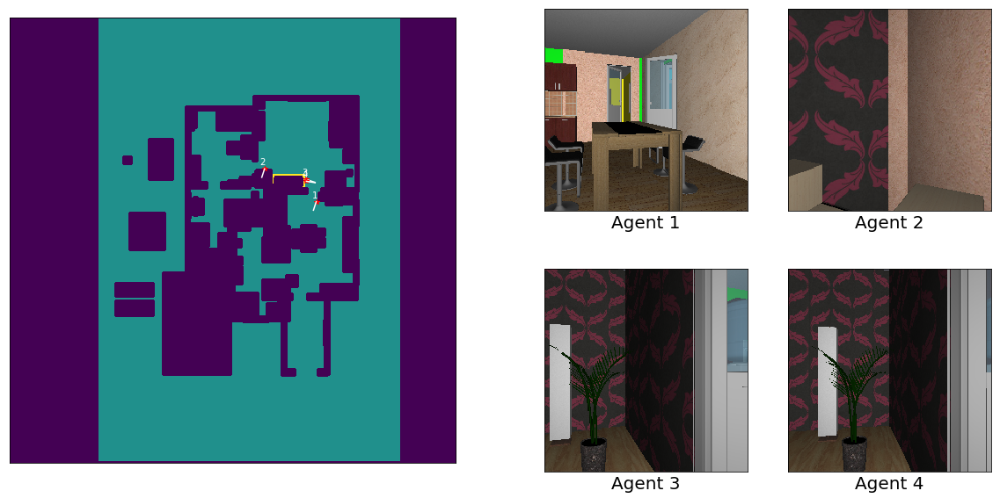

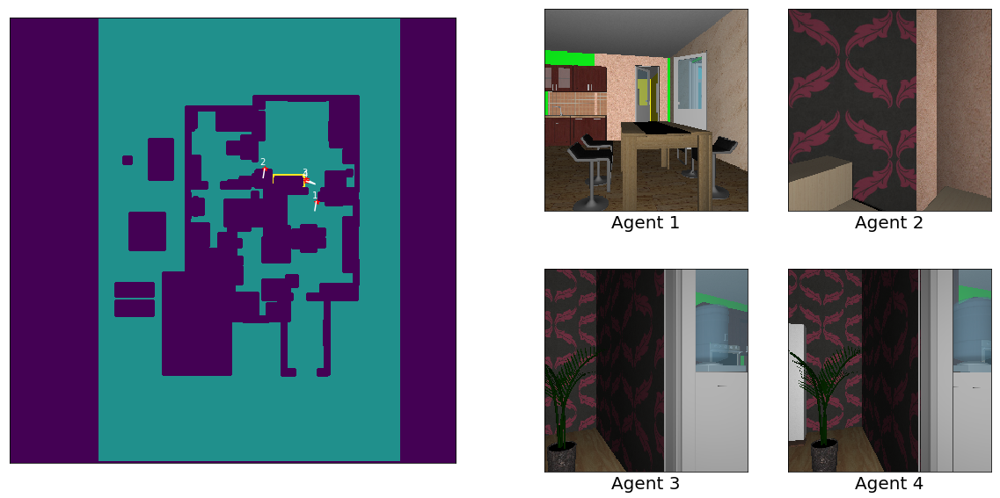

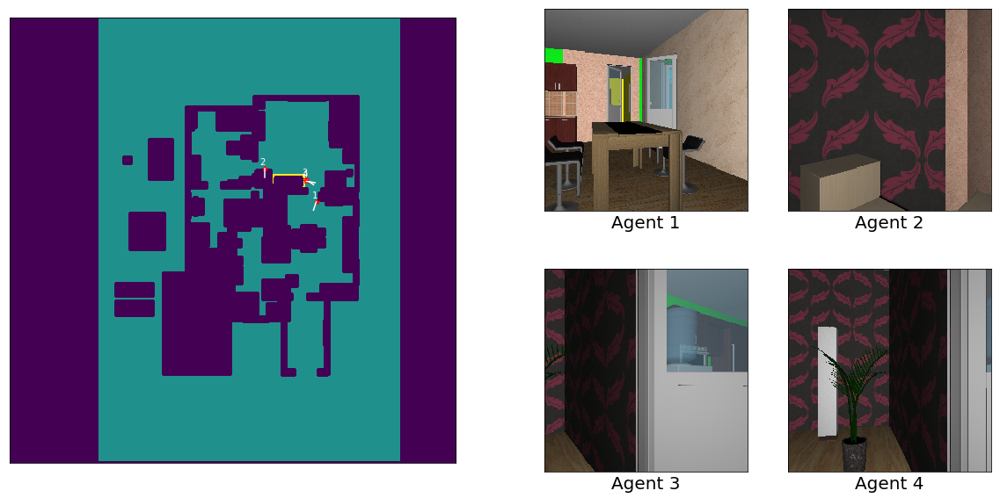

In [8]:
import numpy as np

import matplotlib
# matplotlib.use('Agg')

import matplotlib.pyplot as plt
%matplotlib inline

import torch

import gym 
import gym_house3d

from gym.envs.registration import register

import shutil
import glob
import os
import moviepy.editor as mpy

%load_ext autoreload
%autoreload 2

base_dir = 'checkpoints/09_18/'
fps = 10
root_temp_dir = 'tmp/imgs/09_18/'
root_gif_dir = 'tmp/gifs/09_18/'

# default data params
# difficulty = 'hard'
models = ['09_18_001127_House3DEnv-v0,num_agents=4,num_steps=30,comm_mode=from_states,comm_nhops=1,state_size=128,comm_size=32/']

# register(
#     id='CustomHouse3DEnv-v3',
#     entry_point='gym_house3d.house3d_env:House3DEnv',
#     kwargs={
#         'num_agents': 4,
#         'num_steps': 50,
#         'fix_env': True,
#         'fix_spawn': False
#     })

hparam_str = models[0]

# Retrieve trained model
path = os.path.join(base_dir, hparam_str, "House3DEnv-v0.pt")
actor_critic = torch.load(path, map_location={'cuda:0': 'cpu'})

# Create environment
env = gym.make('CustomHouse3DEnv-v3')

gif_dir = os.path.join(root_gif_dir, hparam_str)
try:
    os.makedirs(gif_dir)
except:
    pass

temp_dir = os.path.join(root_temp_dir, hparam_str)
try:
    os.makedirs(temp_dir)
except:
    pass

# Run episode and save png images with .render()
obs = env.reset()
states = torch.zeros(1, actor_critic.n_agents, actor_critic.state_size)
communications = torch.zeros(1, actor_critic.n_agents, actor_critic.comm_size)
masks = torch.ones(1, 1)

obs = torch.FloatTensor(obs).unsqueeze(0)
value, actions, actions_log_probs, states, communications, aux = actor_critic.act(
    obs, states, communications, masks)
actions = actions[0, :, 0].cpu().numpy()
obs, reward, done, _ = env.step(actions)
print(actions, reward)

env.render(aux=aux, save_dir=temp_dir)

while True:
    obs = torch.FloatTensor(obs).unsqueeze(0)
    value, actions, actions_log_probs, states, communications, aux = actor_critic.act(
        obs, states, communications, masks)
    actions = actions[0, :, 0].cpu().numpy()
    obs, reward, done, _ = env.step(actions)
    print(env.n_steps)
    print(actions, reward)
    env.render(aux=aux, save_dir=temp_dir)
    if done:
        break

# Create gif
gif_name = os.path.join(gif_dir, 'viz.mp4')
file_list = glob.glob(temp_dir + '*.png')
file_list.sort()
clip = mpy.ImageSequenceClip(file_list, fps=fps)
clip.write_videofile(gif_name, fps=fps)

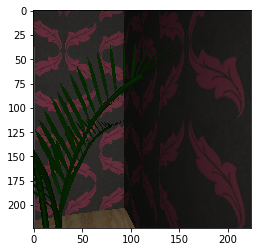

In [16]:


plt.imshow(np.transpose(obs[0], (1, 2, 0)))
# np.transpose(obs[0], (1, 2, 0)).shape

In [7]:
import torch
import os

print(os.environ['CUDA_VISIBLE_DEVICES'])

2
